# Function Setting

In [31]:
import numpy as np
import matplotlib.pyplot as plt

def EluDist(x, y):
    return np.sqrt(np.sum((x-y) * (x-y), axis = 1))

def Loss(centroid, X, label):
    loss = 0
    for i in range(len(label)):
        loss += np.sum((centroid[label[i]-1,:] - X[i,:]) ** 2)
    return loss

def Kmeans(k, X, label):
    centroid = np.zeros((k, X.shape[1]))
  
    for i in range(1, k+1):
        ind = []
        for j in range(len(label)):
            if label[j] == i:
                ind.append(j)
        centroid[i-1,:] = np.sum(X[ind], axis = 0) / len(ind)
        
    for i in range(len(label)):
        label[i] = np.argmin(EluDist(centroid, X[i,:])) + 1
    
    return centroid, label


def Clustering(k, X, init_label):
    label = init_label.copy()
    while True:
        prev = label.copy()
        centroid, label = Kmeans(k, X, label)
        if np.array_equal(label, prev):
            break
    
    loss = Loss(centroid, X, label)
    return centroid, label, loss

# Parameter Setting

In [90]:
label = np.loadtxt("test.txt").astype(int)
data = np.loadtxt("expression.txt")
data = data.T
k = 5
label_r = np.random.randint(low = 1, high = 6, size=data.shape[0])

# Clustering

In [91]:
centroid, res_label, loss = Clustering(k, data, label)
centroid_r, res_label_r, loss_r = Clustering(k , data, label_r)

# Correlation Coeff

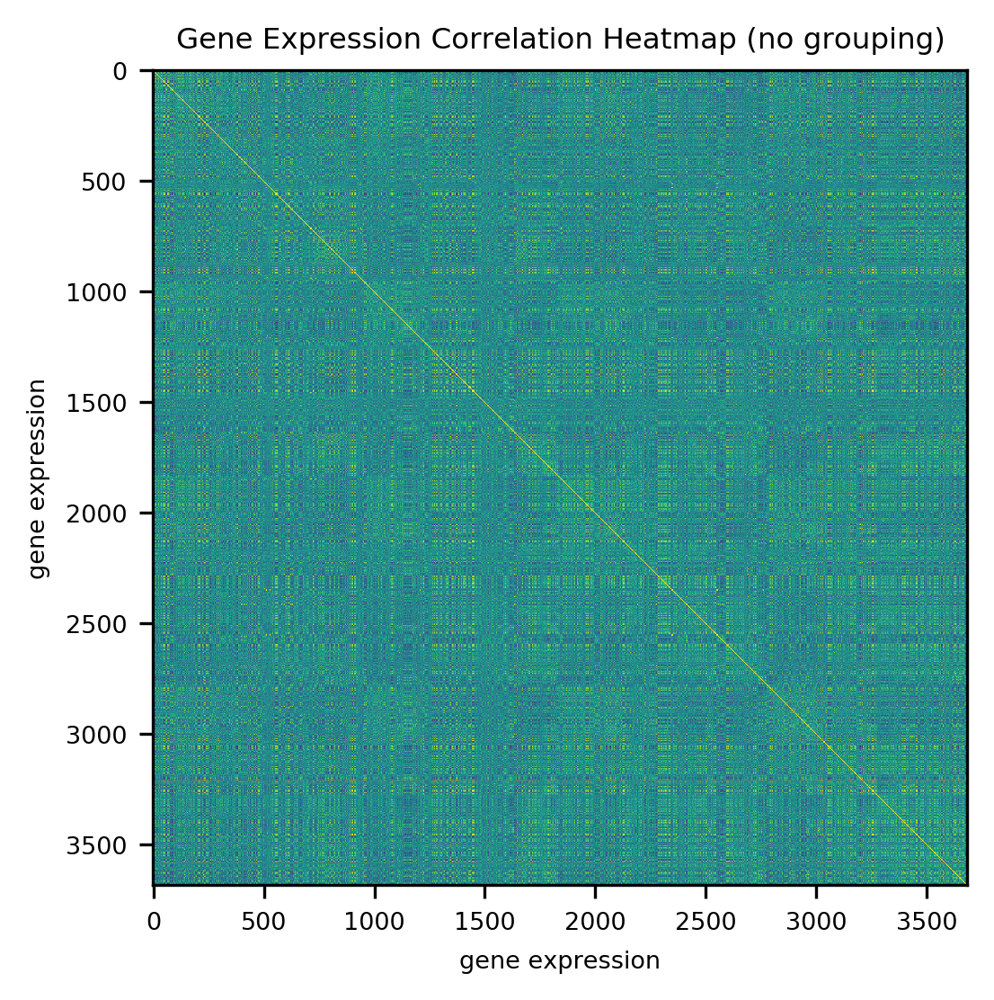

In [100]:
plt.figure(dpi=300)
plt.rc('font', size=6.5)      
plt.imshow(np.corrcoef(data), cmap = "viridis")
plt.xlabel("gene expression")
plt.ylabel("gene expression")
plt.title("Gene Expression Correlation Heatmap (no grouping)")
plt.savefig("figure/raw_corr.png")

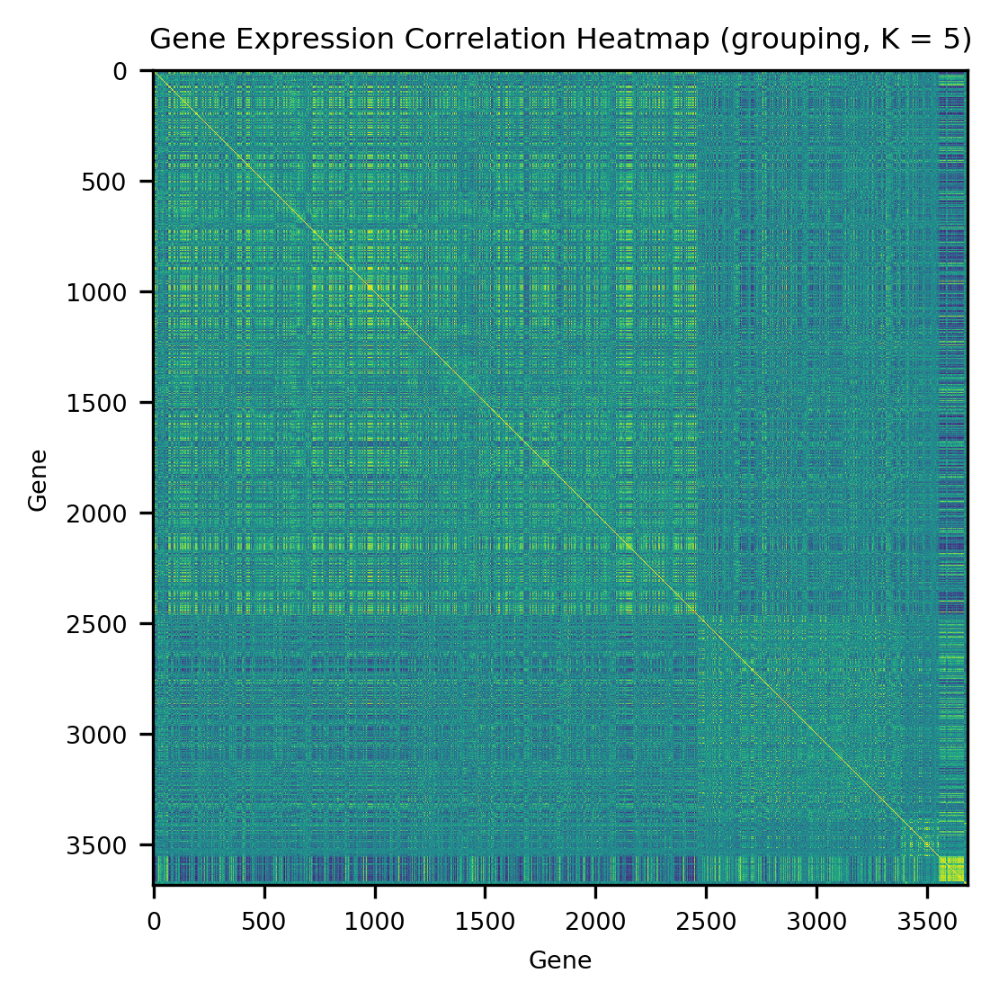

In [101]:
plt.figure(dpi=300)
plt.rc('font', size=6.5)      
plt.imshow(np.corrcoef(data[np.argsort(res_label)]), cmap = "viridis")
plt.xlabel("Gene")
plt.ylabel("Gene")
plt.title("Gene Expression Correlation Heatmap (grouping, K = 5)")
plt.savefig("figure/5means_corr.png")

In [52]:
print(loss, loss_r)

61443.464101796686 61443.464101796686


# Ten Random Try

61443.464101796686
61443.464101796686
61443.464101796686
61443.464101796686
61836.9884238052
61443.464101796686
61443.464101796686
61443.464101796686
61443.464101796686
61836.9884238052


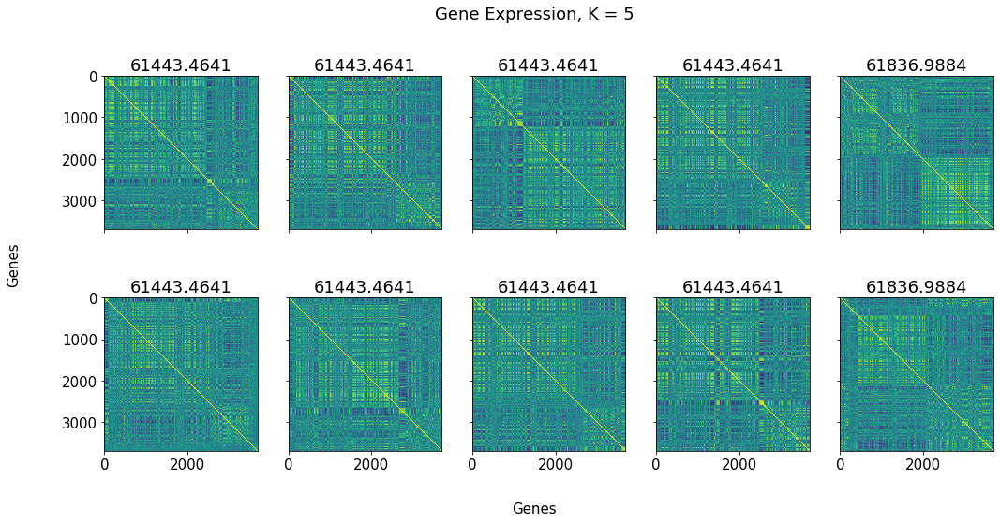

In [120]:
plt.rc('font', size=15)  
fig, axes = plt.subplots(
    nrows=2, ncols=5, sharex=True, sharey=True, figsize = (17,8)
)
for i in range(10):
    label_r = np.random.randint(low = 1, high = 6, size=data.shape[0])
    centroid_r, res_label_r, loss_r = Clustering(k , data, label_r)
    ax = axes[int(i / 5), int(i % 5)]
    ax.imshow(np.corrcoef(data[np.argsort(res_label_r)]), cmap = "viridis")
    ax.title.set_text("{0:.4f}".format(loss_r))
    print(loss_r)
fig.suptitle("Gene Expression, K = 5")
fig.text(0.5, 0.04, 'Genes', ha='center')
fig.text(0.04, 0.5, 'Genes', va='center', rotation='vertical')
plt.savefig("figure/5means_corr_10ran_2.png")

# Different k

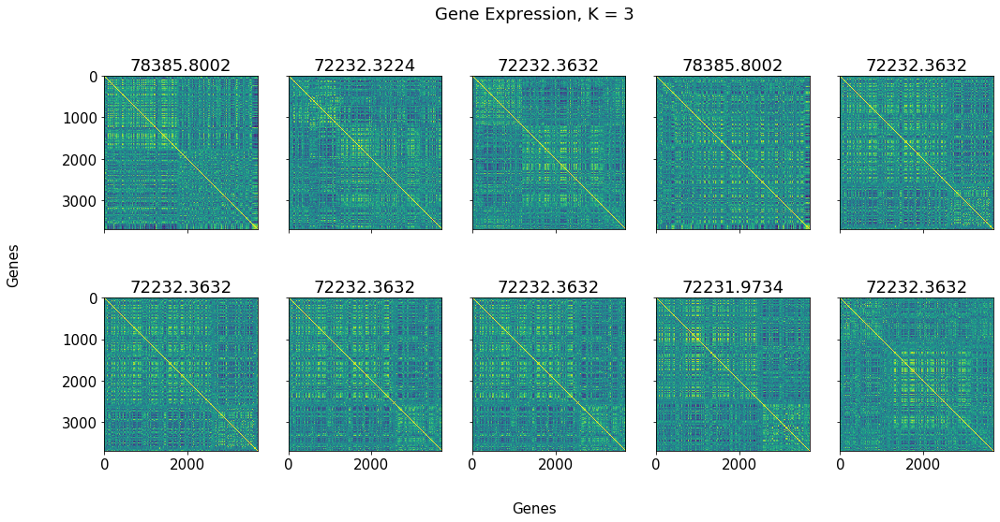

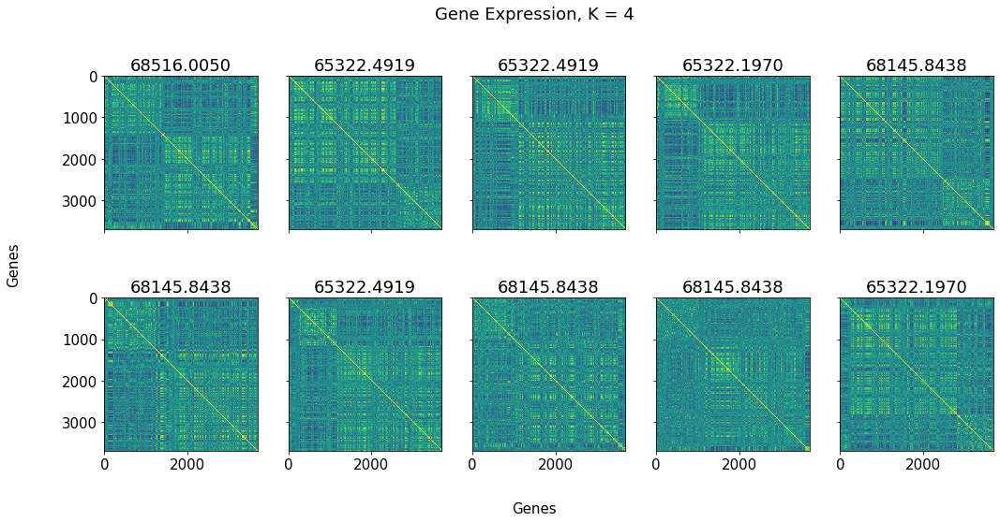

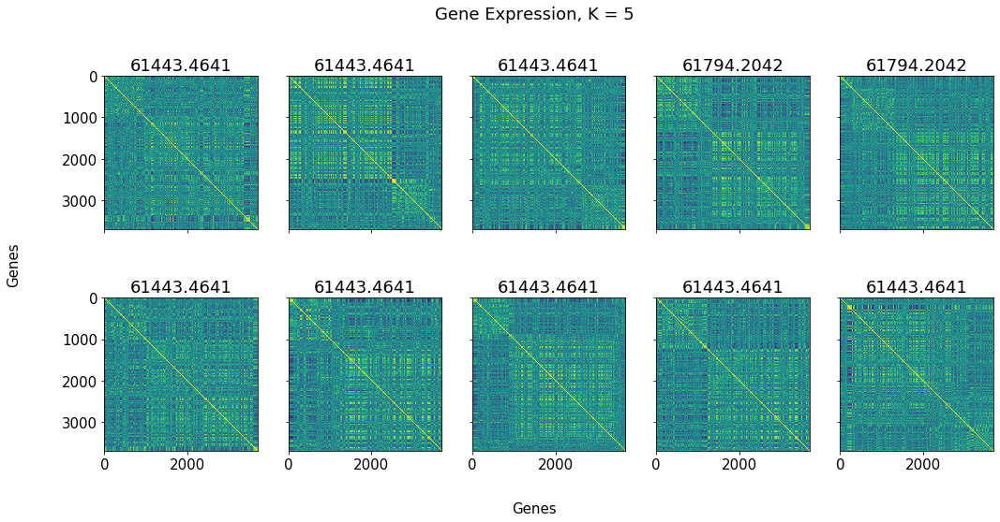

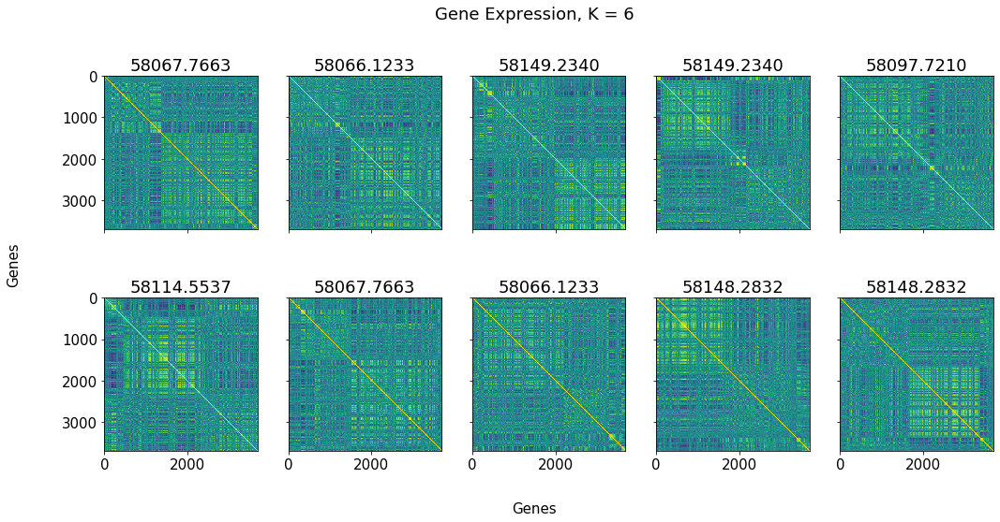

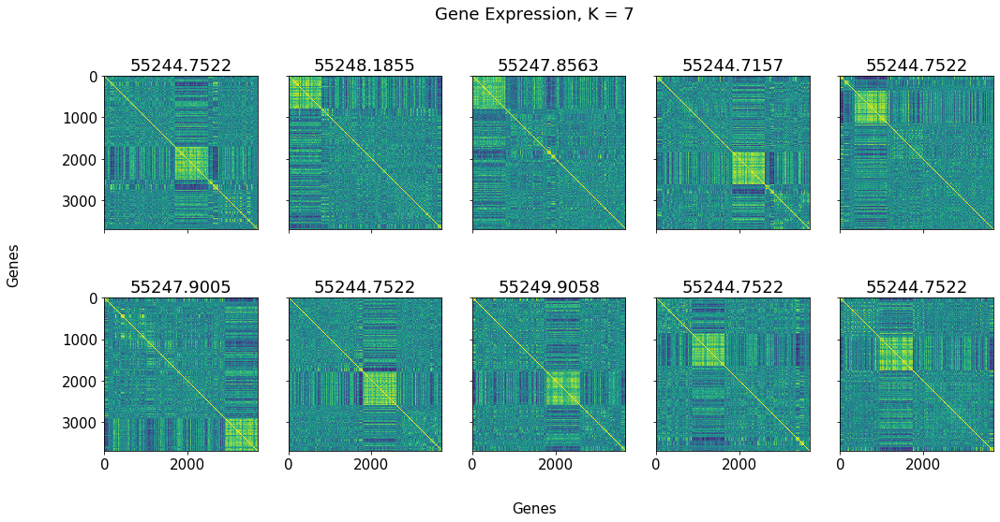

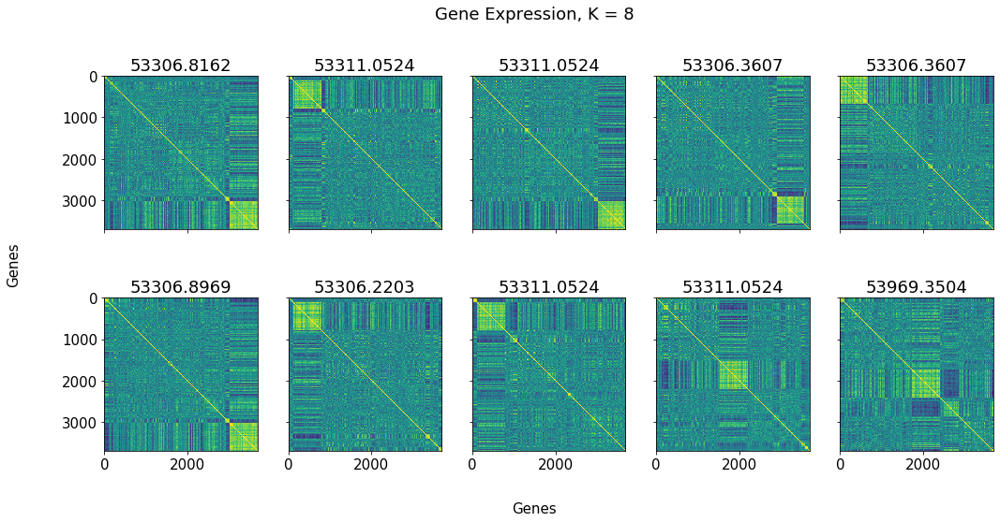

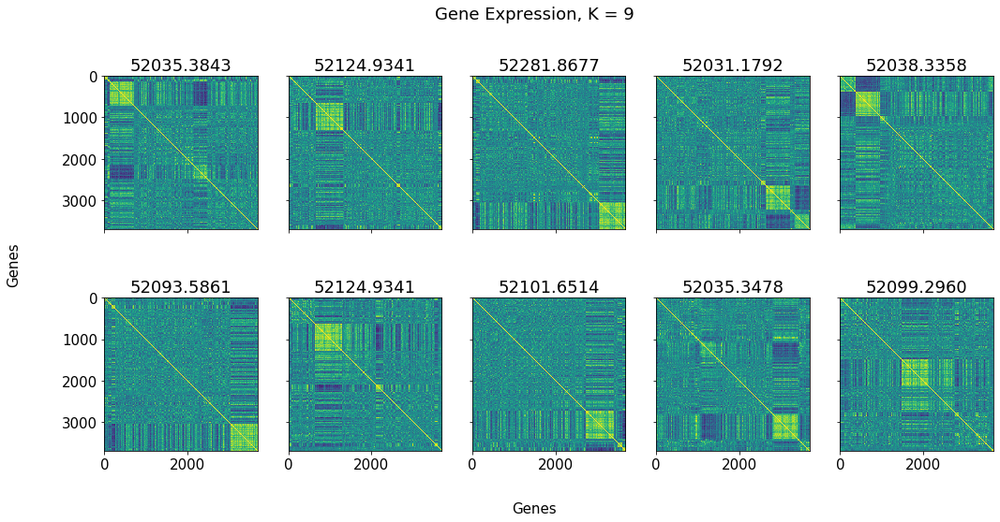

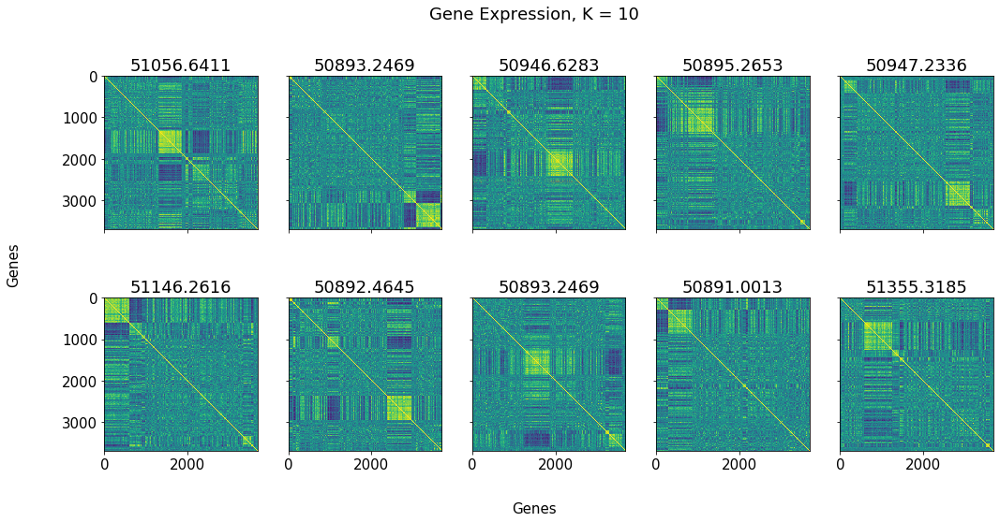

In [121]:
average_loss = []
for i in range(3,11):
    loss_sum = 0
    plt.rc('font', size=15)  
    fig, axes = plt.subplots(
        nrows=2, ncols=5, sharex=True, sharey=True, figsize = (17,8)
    )
    for s in range(10):
        label_r = np.random.randint(low = 1, high = i + 1, size=data.shape[0])
        centroid_r, res_label_r, loss_r = Clustering(i , data, label_r)
        loss_sum += loss_r
        ax = axes[int(s / 5), int(s % 5)]
        ax.imshow(np.corrcoef(data[np.argsort(res_label_r)]), cmap = "viridis")
        ax.title.set_text("{0:.4f}".format(loss_r))
    fig.suptitle("Gene Expression, K = " + str(i))
    fig.text(0.5, 0.04, 'Genes', ha='center')
    fig.text(0.04, 0.5, 'Genes', va='center', rotation='vertical')
    plt.savefig("figure/" + str(i) + "means_corr_10ran_3.png")
    average_loss.append(loss_sum / 10.)

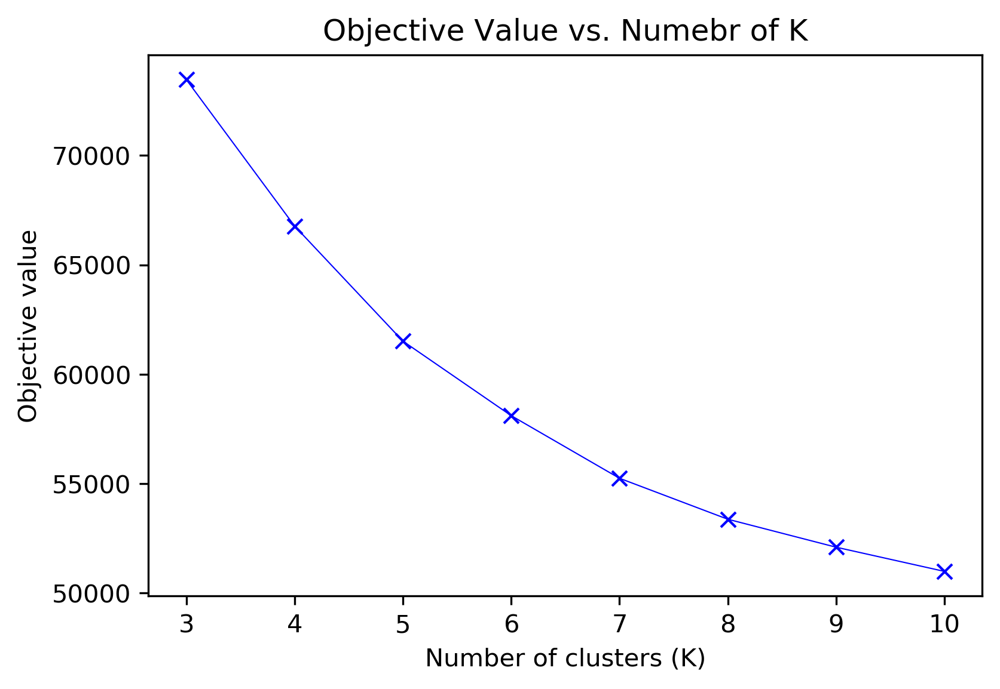

In [124]:
x = [3,4,5,6,7,8,9,10]
plt.figure(dpi = 300)
plt.rc('font', size=10) 
plt.plot(x, average_loss,'bx-', linewidth = 0.5)
plt.xlabel("Number of clusters (K)")
plt.ylabel("Objective value")
plt.title("Objective Value vs. Numebr of K")
plt.savefig("figure/best_k.png")

# Sklearn Agglomerative Clustering

In [126]:
from sklearn.cluster import AgglomerativeClustering

In [127]:
data = np.loadtxt("expression.txt")
data = data.T


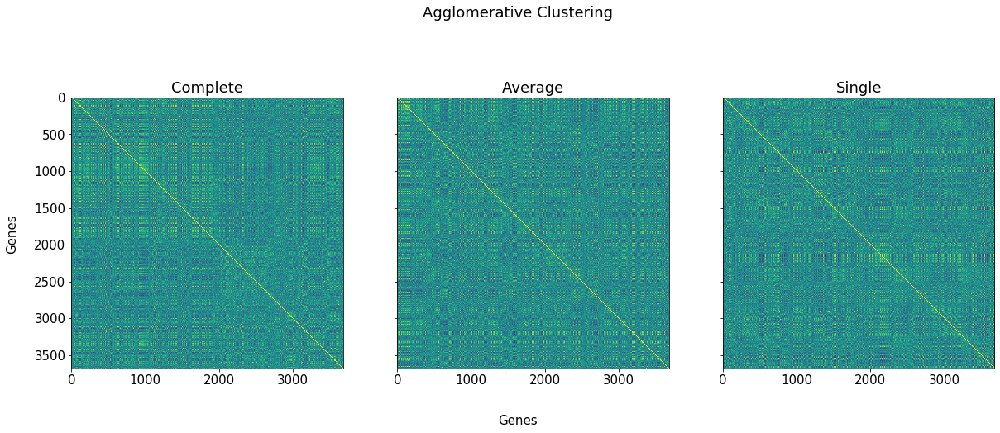

In [133]:
plt.rc('font', size=15)  
fig, axes = plt.subplots(
    nrows=1, ncols=3, sharex=True, sharey=True, figsize = (20,8)
)
data_complete = AgglomerativeClustering(n_clusters = 5, linkage = "complete")
data_complete.fit(data)

data_avg = AgglomerativeClustering(n_clusters = 5, linkage = "average")
data_avg.fit(data)

data_single = AgglomerativeClustering(n_clusters = 5, linkage = "single")
data_single.fit(data)

ax = axes[0]
ax.imshow(np.corrcoef(data[np.argsort(data_complete.labels_)]), cmap = "viridis")
ax.title.set_text("Complete")
ax = axes[1]
ax.imshow(np.corrcoef(data[np.argsort(data_avg.labels_)]), cmap = "viridis")
ax.title.set_text("Average")
ax = axes[2]
ax.imshow(np.corrcoef(data[np.argsort(data_single.labels_)]), cmap = "viridis")
ax.title.set_text("Single")

fig.suptitle("Agglomerative Clustering")
fig.text(0.5, 0.1, 'Genes', ha='center')
fig.text(0.07, 0.5, 'Genes', va='center', rotation='vertical')
plt.savefig("figure/AgglomerativeClustering")

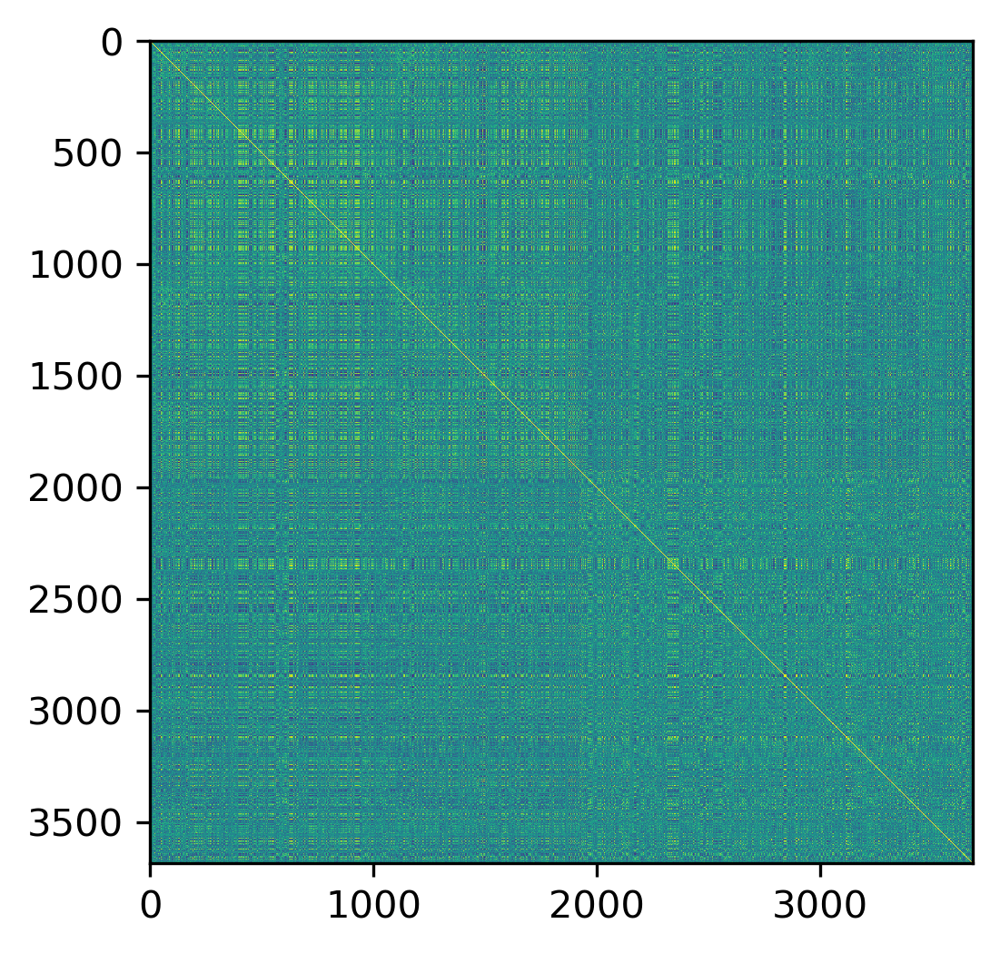

In [12]:
data_complete = AgglomerativeClustering(n_clusters = 5, linkage = "complete")
data_complete.fit(data)
plt.figure(dpi=300)
plt.imshow(np.corrcoef(data[np.argsort(data_complete.labels_)]), cmap = "viridis")

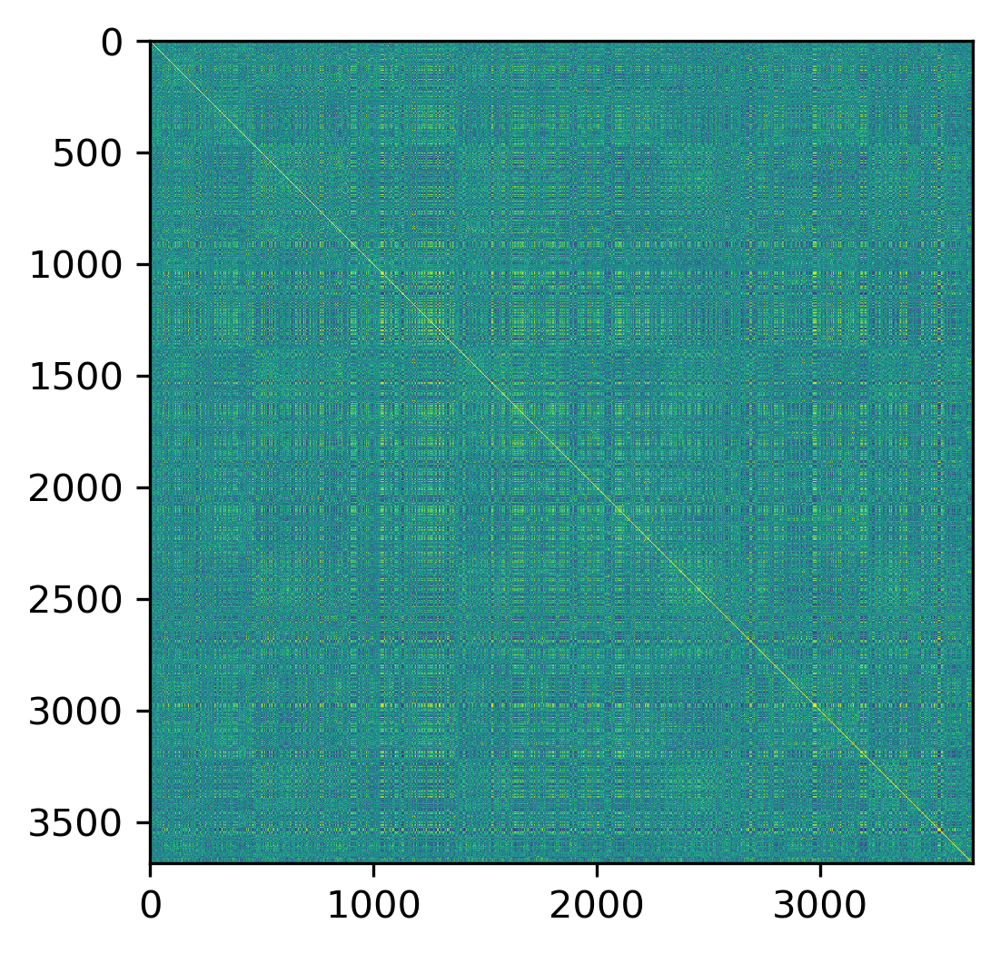

In [13]:
data_avg = AgglomerativeClustering(n_clusters = 5, linkage = "average")
data_avg.fit(data)
plt.figure(dpi=300)
plt.imshow(np.corrcoef(data[np.argsort(data_avg.labels_)]), cmap = "viridis")

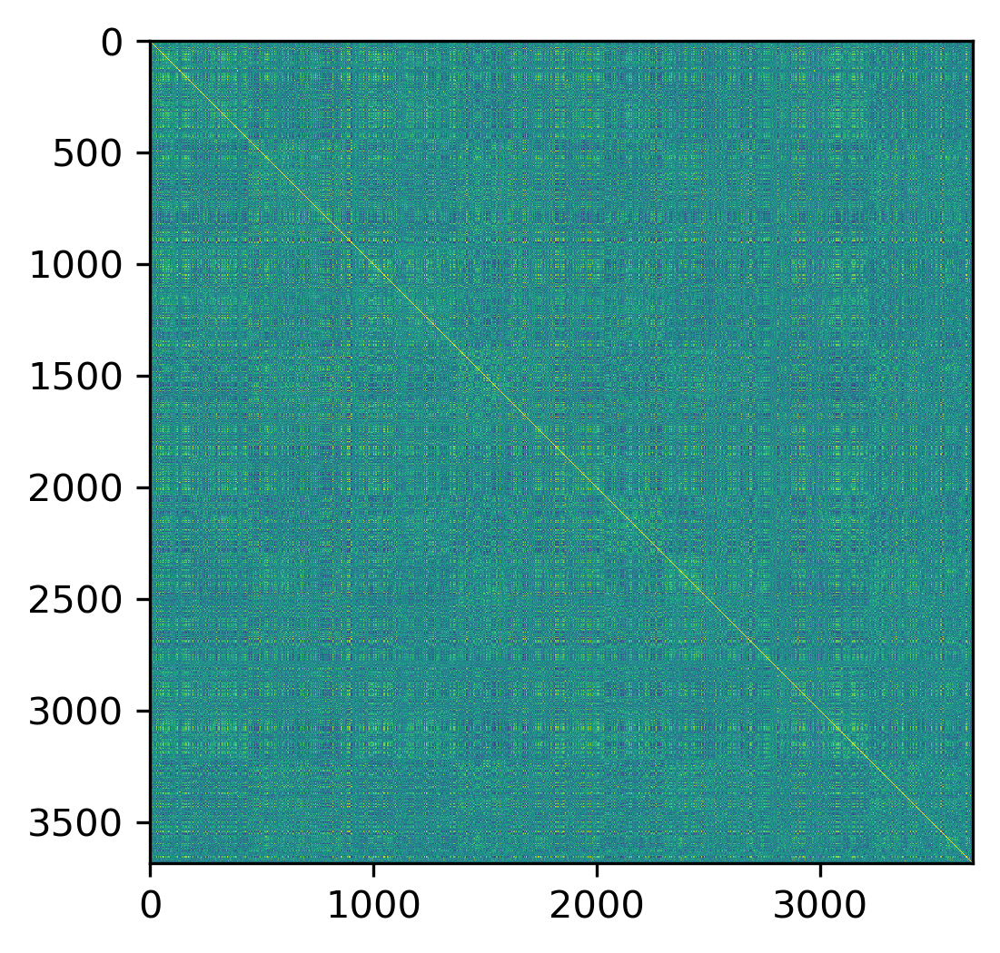

In [20]:
data_single = AgglomerativeClustering(n_clusters = 5, linkage = "single")
data_single.fit(data)
plt.figure(dpi=300)
plt.imshow(np.corrcoef(data[np.argsort(data_single.labels_)]), cmap = "viridis")

In [34]:
min(data_avg.labels_)

0

# Sklearn Check

In [5]:
from sklearn.cluster import KMeans

In [53]:
data_check = KMeans(n_clusters = 8)
data_check.fit(data)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=8, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

In [50]:
(data_check.labels_+1)[:100]

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 1, 1, 1, 1, 1, 1, 3, 1, 1, 1,
       1, 2, 1, 1, 1, 4, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       2, 2, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 1, 1, 2, 2, 1, 2, 1, 1,
       1, 1, 2, 1, 1, 1, 4, 1, 2, 1, 1, 3, 2, 1, 1, 1, 2, 1, 2, 1, 1, 3,
       1, 1, 4, 2, 2, 2, 1, 1, 2, 1, 1, 4])

In [54]:
loss_check = Loss(data_check.cluster_centers_, data, data_check.labels_ + 1)
loss_check

51744.39366148297